# Evaluating the models on out-sample data

This notebook can be used to load and evaluate the pretrained models on an arbitrary set of videos.

In [1]:
%matplotlib inline
import warnings
import json
import numpy as np
from scipy import interp
import matplotlib.pyplot as plt
import torch

from src.util import predict_files, initialize_model, get_model_path

warnings.filterwarnings("ignore")

In [2]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

## Configuration

In the next cell we specify which model we want to evaluate. 
Available models are:

**Image-based:** 
1. MesoNet4 
2. EfficientNet B3

**Video-based:**

3. MesoNet4 + LSTM
4. EfficientNet B0 + LSTM


Next to this we want to choose whether to use a model trained on either clean data or data augmented using perturbations.

In [3]:
# init model

model = 1             # choose model type
checkpoint = 39       # pick up training from checkpoint 

# define model name to be evaluated
model_name = "meso4test_do0.5_wd0.0001_lr0.0001_dataclean"

# get model_class for init, get logging dir for model 
model_class, log_dir = get_model_path(model, model_name, pretrained=True) 

# training can be picked up from any epoch. if pretrained is set to True, an epoch must be specified
model, temporal = initialize_model(model_class, log_dir, pretrained=True,
                                   epoch=checkpoint, device=device)
model.to(device)

MesoNet4(
  (convs): Sequential(
    (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): ReLU()
    (2): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(8, 8, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (5): ReLU()
    (6): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(8, 16, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (9): ReLU()
    (10): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): Conv2d(16, 16, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (13): ReLU()
    (14): BatchNorm2d(16, eps=1e-05, mo

## Data

Next, specify the path to data. In the data folder, there must be two subfolders, named 'real' and 'fake', holding the respective instances of pristine or manipulated videos.
Also, number of frames used for each video can be changes. NOTE: Using less than 5 frames for temporal models is not possible.

In [4]:
file_path = f'data/{"temporal" if temporal else "nontemp"}/testfiles/'
n_frames = 10

Label: fake
Fake prob: 0.9690653085708618


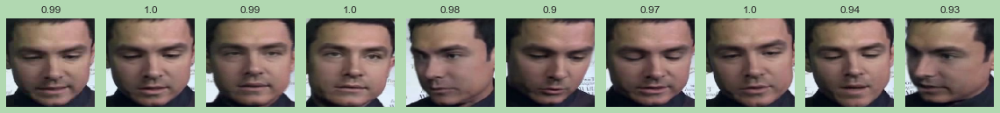

Label: fake
Fake prob: 0.8112468123435974


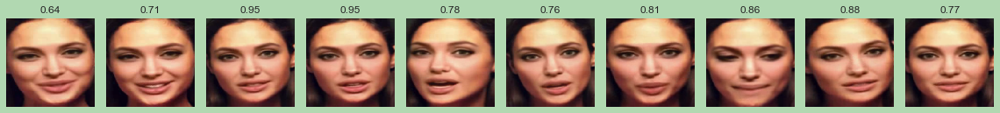

Label: fake
Fake prob: 0.676564633846283


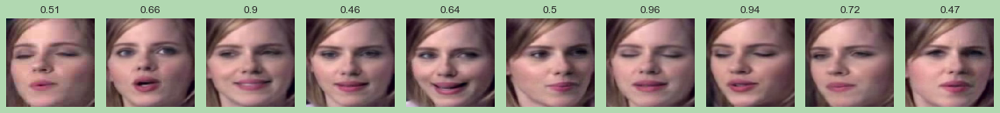

Label: fake
Fake prob: 0.7410020232200623


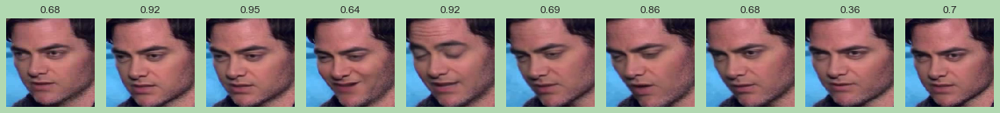

Label: fake
Fake prob: 0.9738737940788269


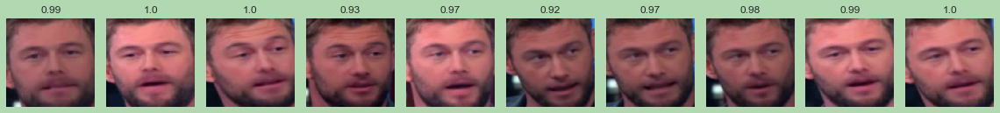

Label: fake
Fake prob: 0.9555093050003052


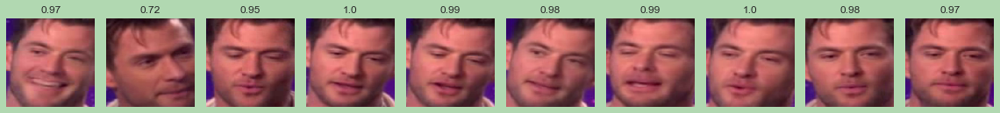

Label: fake
Fake prob: 0.9312815070152283


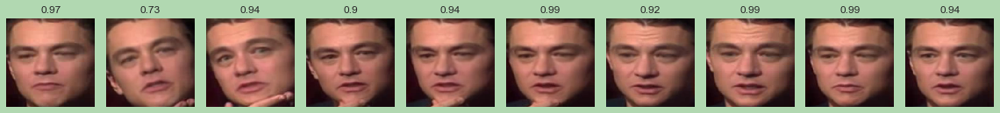

Label: fake
Fake prob: 0.9507827758789062


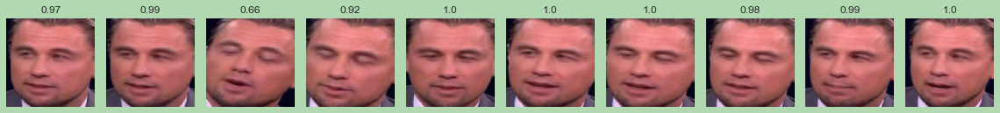

Label: fake
Fake prob: 0.9305686950683594


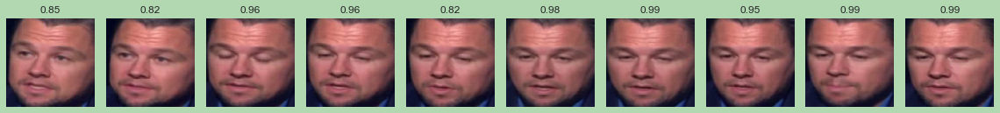

Label: fake
Fake prob: 0.8876376152038574


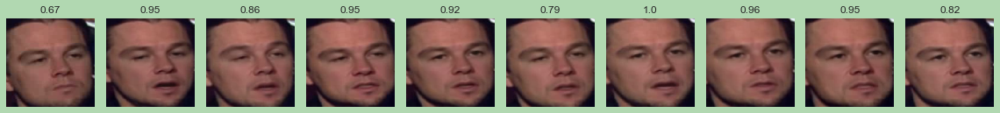

Label: fake
Fake prob: 0.9830199480056763


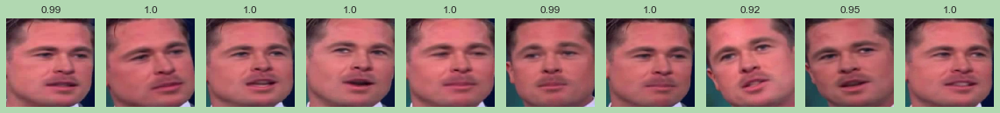

Label: fake
Fake prob: 0.9932076334953308


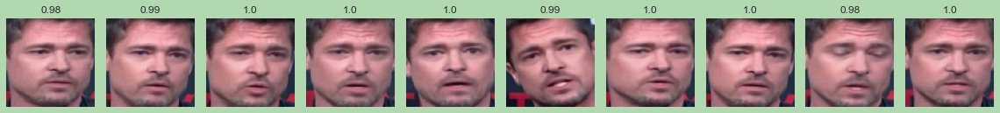

Label: fake
Fake prob: 0.8646526336669922


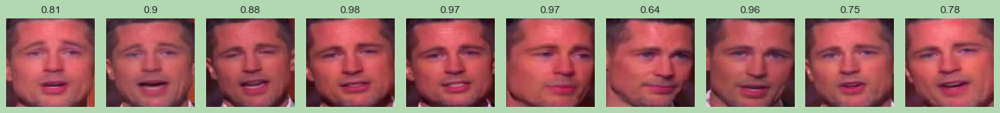

Label: fake
Fake prob: 0.8080803751945496


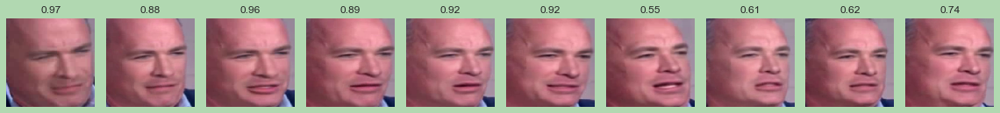

Label: fake
Fake prob: 0.9171735644340515


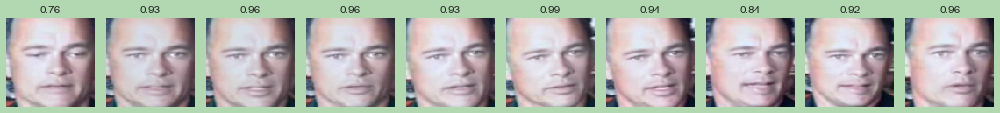

Label: fake
Fake prob: 0.9601796269416809


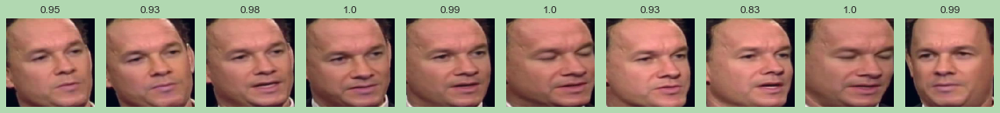

Label: fake
Fake prob: 0.9727103114128113


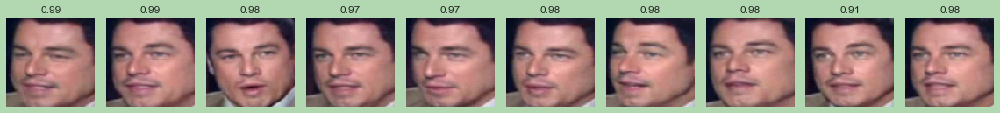

Label: fake
Fake prob: 0.9832925796508789


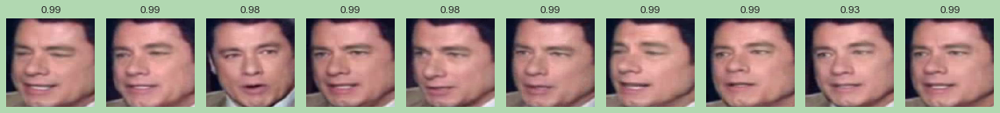

Label: fake
Fake prob: 0.9945551156997681


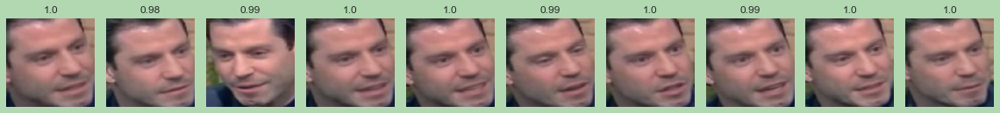

Label: fake
Fake prob: 0.9940542578697205


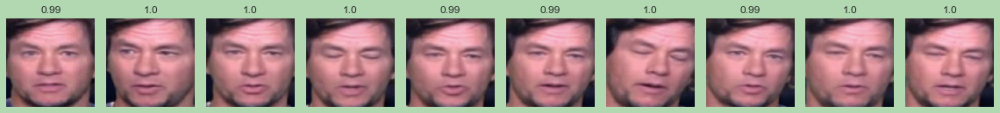

Label: fake
Fake prob: 0.9801875948905945


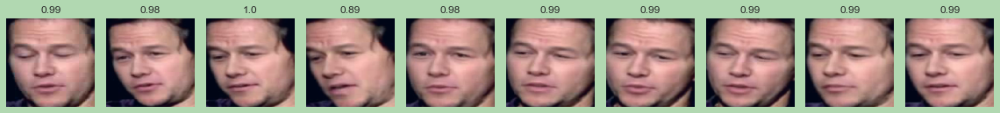

Label: fake
Fake prob: 0.6831486225128174


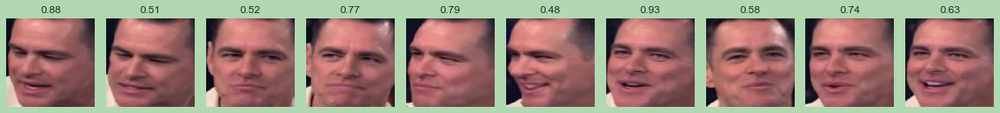

Label: fake
Fake prob: 0.8402061462402344


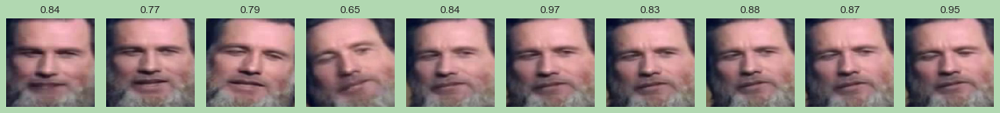

Label: fake
Fake prob: 0.7740159034729004


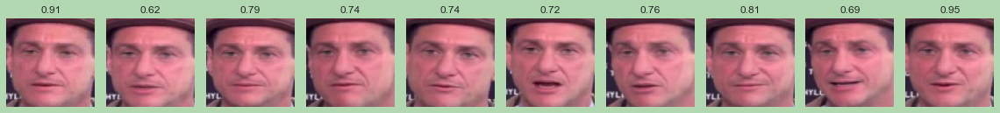

Label: fake
Fake prob: 0.7647544741630554


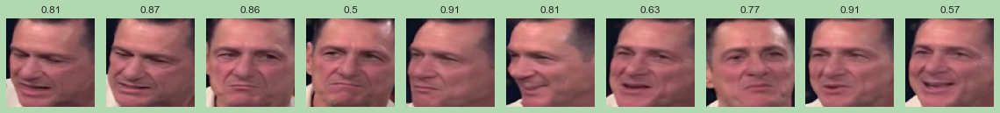

Label: fake
Fake prob: 0.9533435702323914


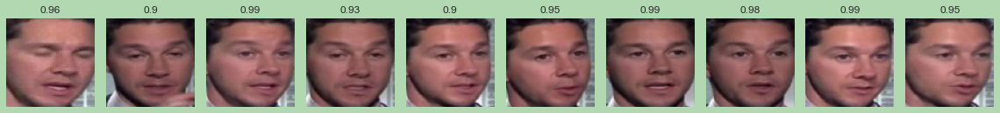

Label: fake
Fake prob: 0.6068901419639587


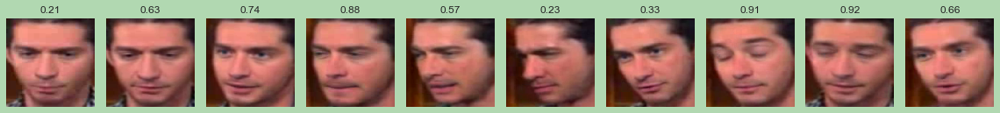

Label: fake
Fake prob: 0.881525993347168


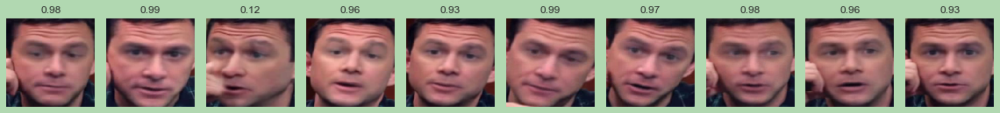

Label: fake
Fake prob: 0.9983372688293457


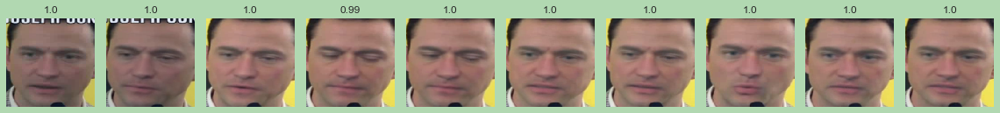

Label: fake
Fake prob: 0.9438461661338806


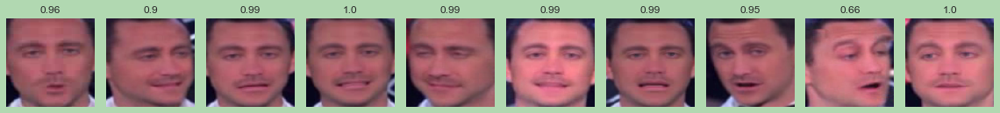

Label: fake
Fake prob: 0.8518722653388977


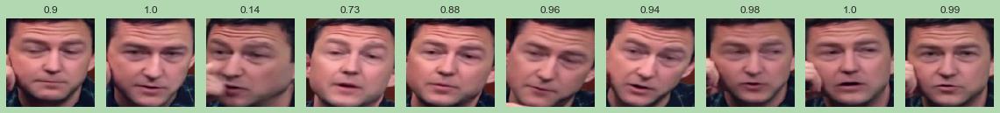

Label: fake
Fake prob: 0.983768880367279


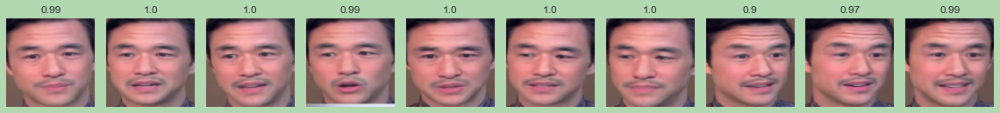

Label: fake
Fake prob: 0.9377689361572266


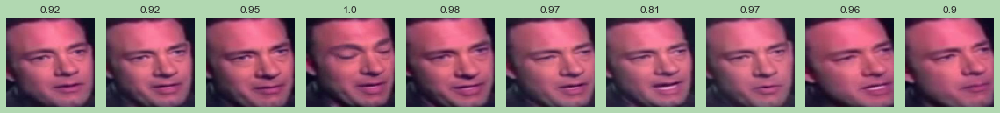

Label: fake
Fake prob: 0.8492439389228821


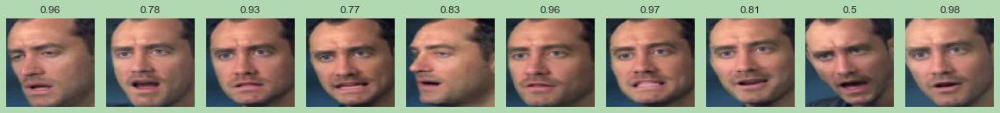

Label: fake
Fake prob: 0.6810604333877563


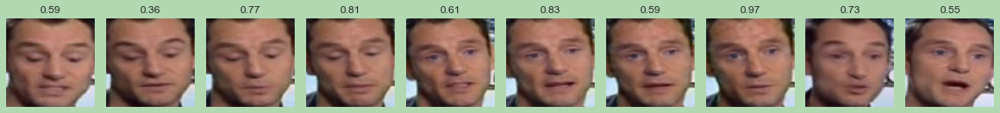

Label: fake
Fake prob: 0.9657737016677856


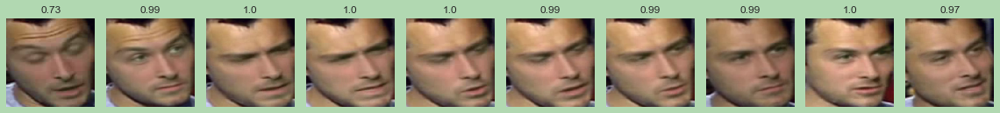

Label: fake
Fake prob: 0.8748760223388672


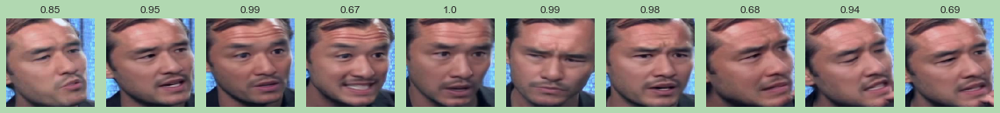

Label: fake
Fake prob: 0.8154911994934082


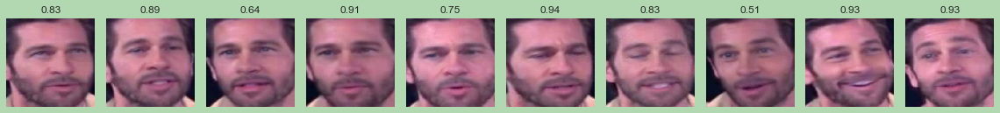

Label: fake
Fake prob: 0.9055571556091309


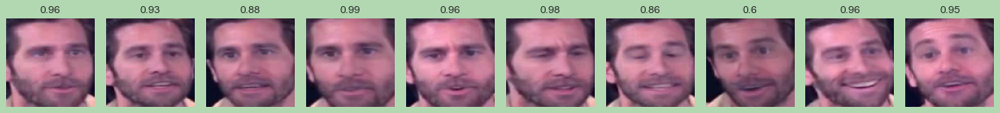

Label: fake
Fake prob: 0.8842832446098328


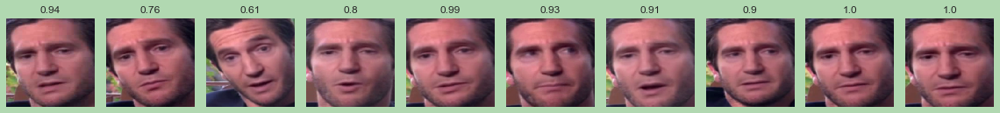

Label: fake
Fake prob: 0.9886974692344666


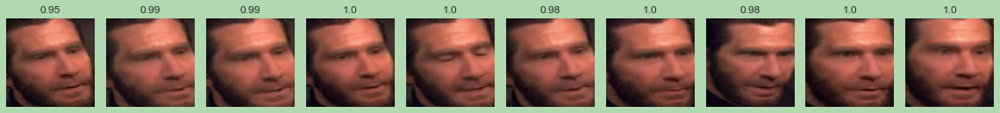

Label: fake
Fake prob: 0.9396207928657532


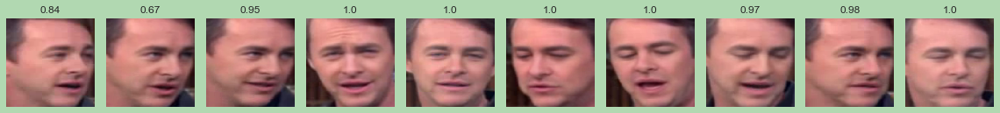

Label: fake
Fake prob: 0.969107449054718


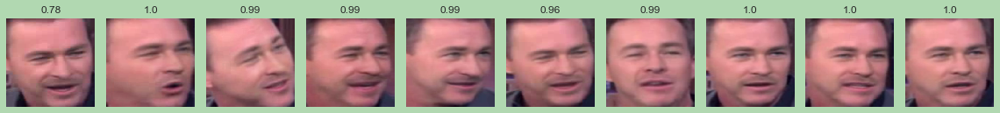

Label: fake
Fake prob: 0.5065324902534485


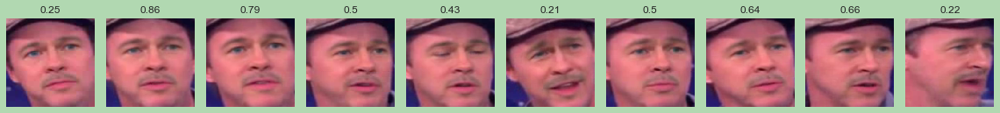

Label: fake
Fake prob: 0.9602996706962585


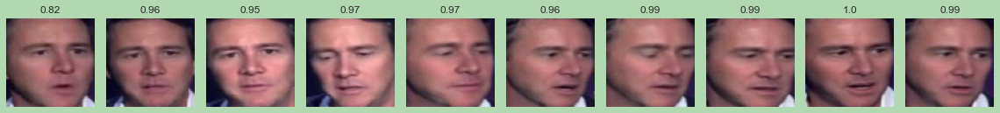

Label: fake
Fake prob: 0.9002130627632141


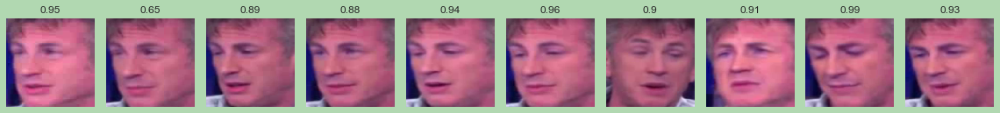

Label: fake
Fake prob: 0.7929647564888


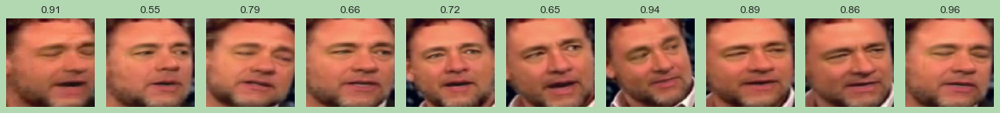

Label: fake
Fake prob: 0.6199869513511658


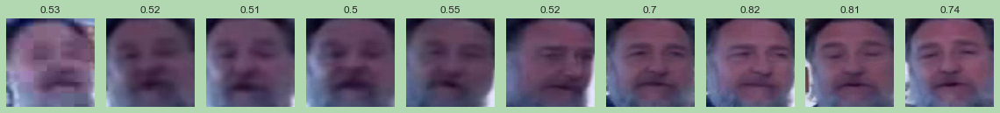

Label: fake
Fake prob: 0.5724517703056335


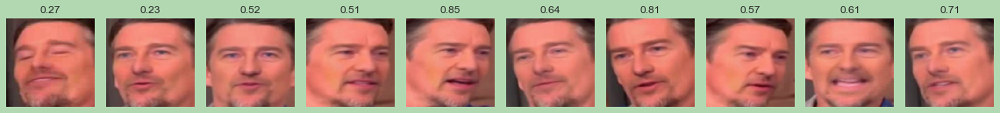

Label: fake
Fake prob: 0.5085232853889465


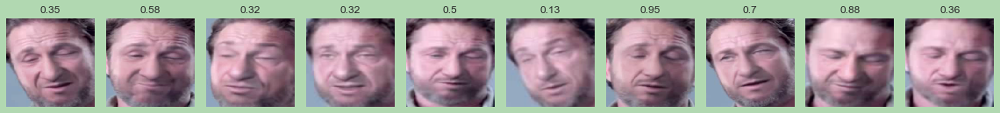

Label: fake
Fake prob: 0.7368740439414978


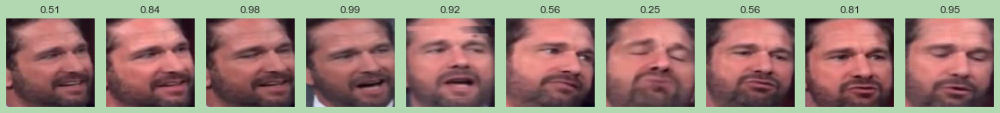

Label: fake
Fake prob: 0.9822306036949158


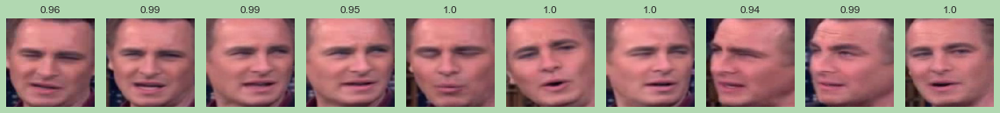

Label: fake
Fake prob: 0.918186604976654


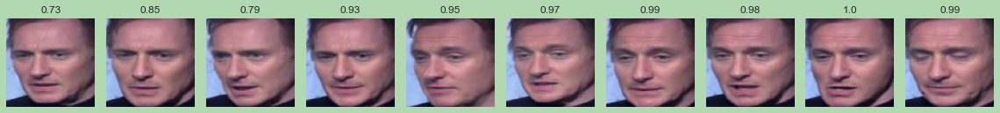

Label: fake
Fake prob: 0.8168822526931763


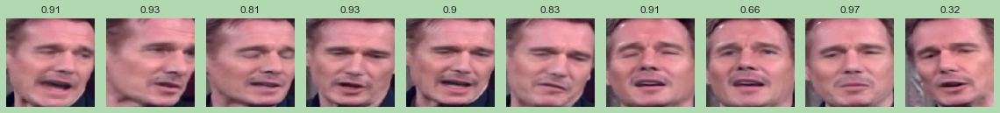

Label: fake
Fake prob: 0.6457874178886414


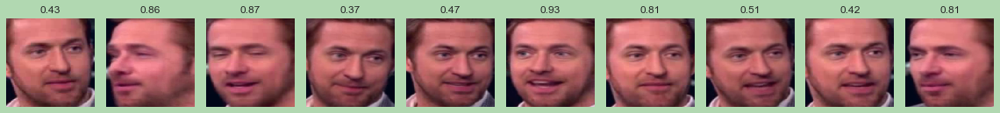

Label: fake
Fake prob: 0.7345189452171326


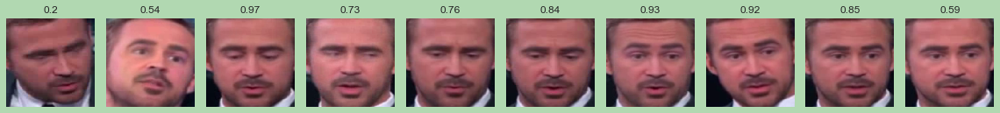

Label: fake
Fake prob: 0.5929180979728699


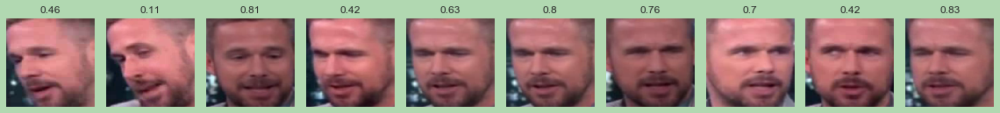

Label: fake
Fake prob: 0.8385561108589172


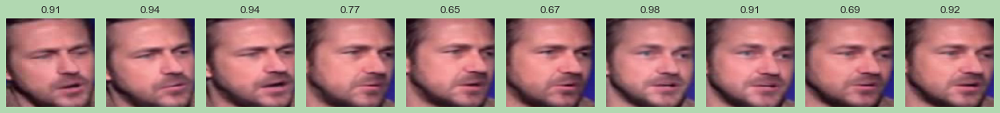

Label: fake
Fake prob: 0.7881504893302917


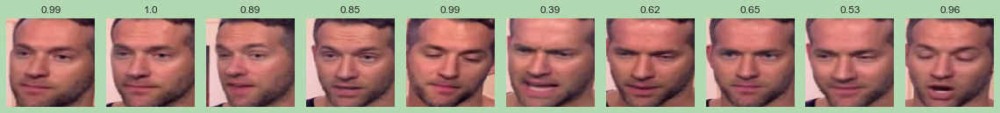

Label: fake
Fake prob: 0.8259984850883484


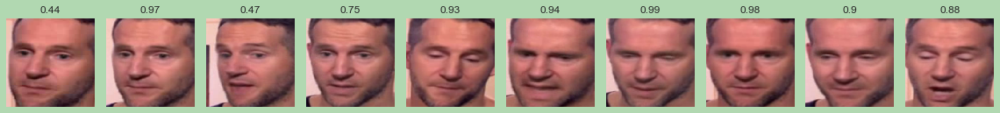

Label: fake
Fake prob: 0.8828825354576111


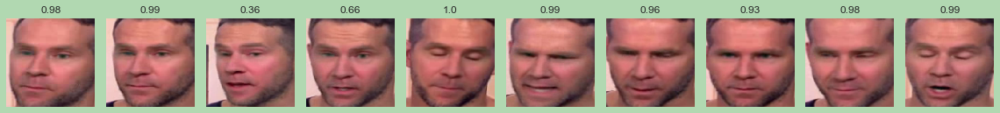

Label: fake
Fake prob: 0.6271564364433289


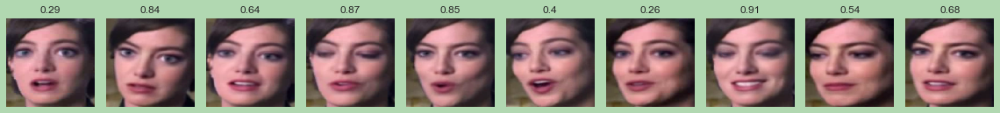

Label: fake
Fake prob: 0.8146905899047852


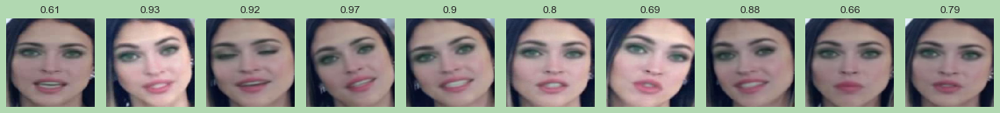

Label: fake
Fake prob: 0.35794684290885925


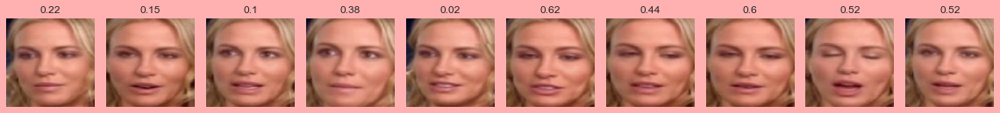

Label: fake
Fake prob: 0.6827496886253357


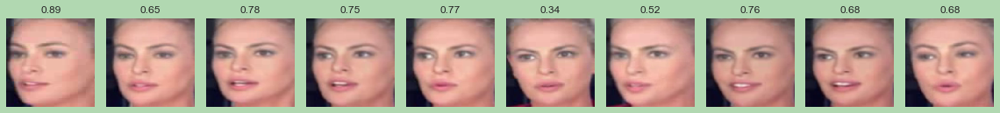

Label: fake
Fake prob: 0.3479115664958954


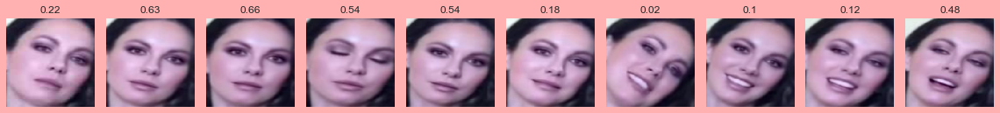

Label: fake
Fake prob: 0.9229769110679626


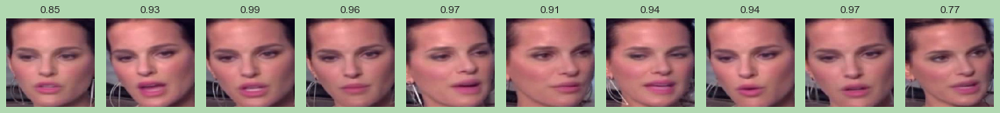

Label: fake
Fake prob: 0.5405640602111816


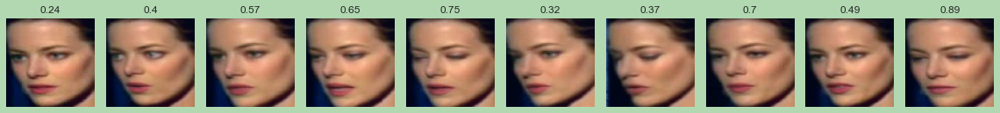

Label: fake
Fake prob: 0.2504306435585022


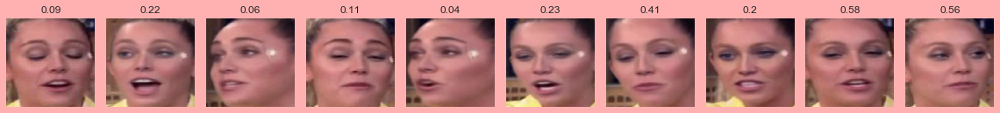

Label: fake
Fake prob: 0.7590406537055969


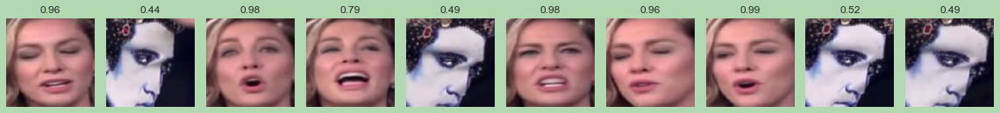

Label: fake
Fake prob: 0.6460658311843872


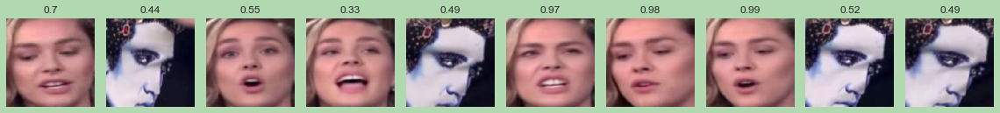

Label: fake
Fake prob: 0.7524614334106445


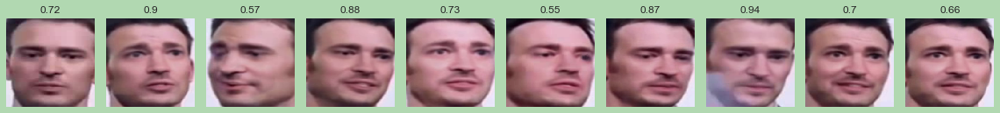

Label: fake
Fake prob: 0.7692353129386902


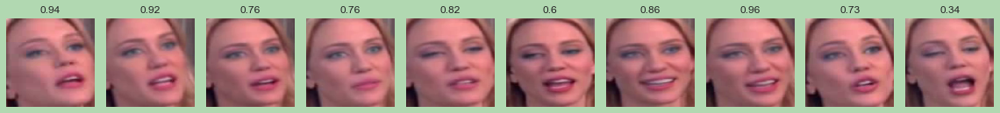

Label: fake
Fake prob: 0.3746233582496643


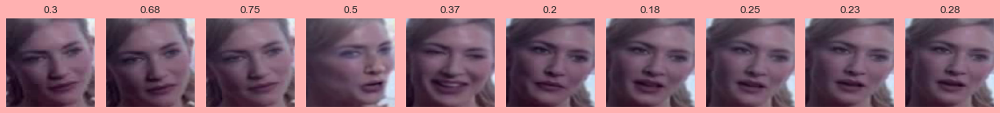

Label: fake
Fake prob: 0.6251093745231628


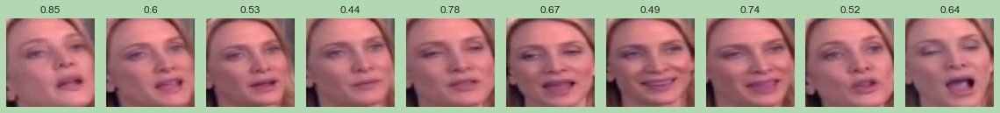

Label: fake
Fake prob: 0.6503515243530273


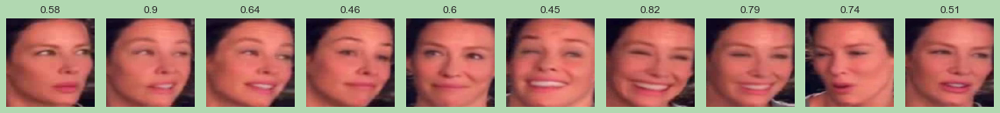

Label: fake
Fake prob: 0.8465662002563477


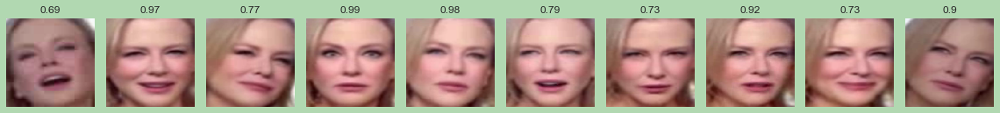

Label: fake
Fake prob: 0.4895094037055969


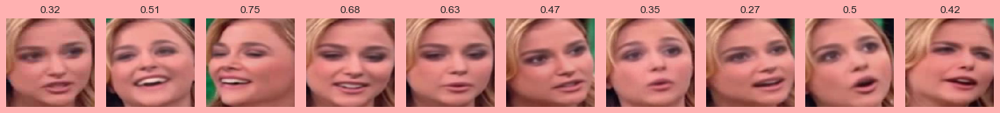

Label: fake
Fake prob: 0.35172581672668457


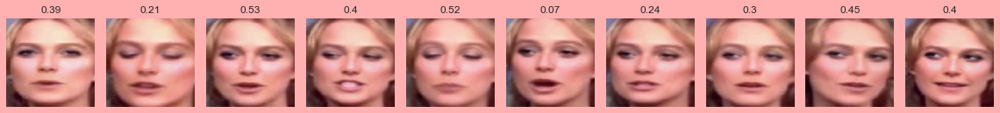

Label: fake
Fake prob: 0.603539764881134


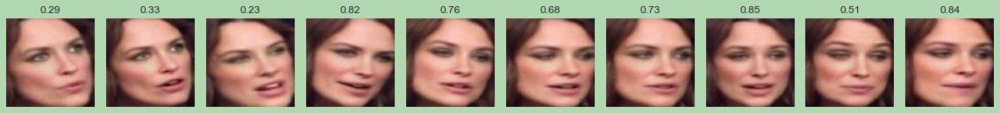

Label: fake
Fake prob: 0.9509539008140564


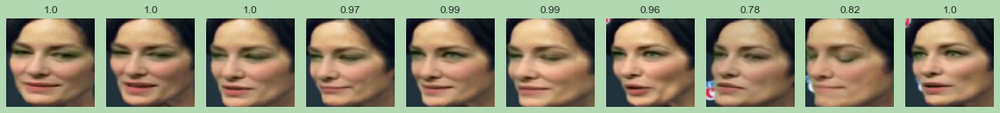

Label: fake
Fake prob: 0.9052597880363464


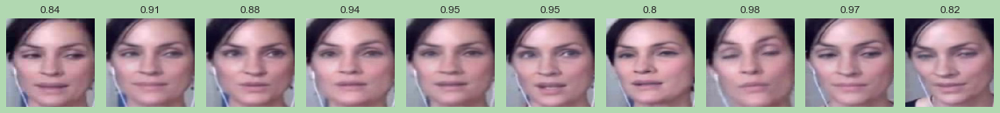

Label: fake
Fake prob: 0.8187218904495239


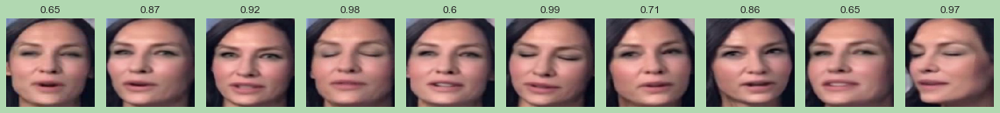

Label: fake
Fake prob: 0.9553985595703125


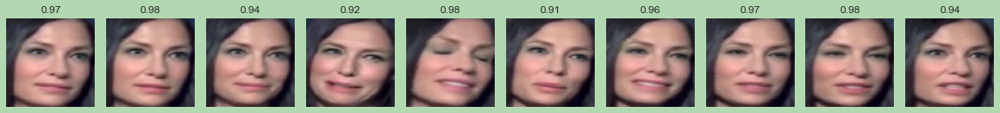

Label: fake
Fake prob: 0.7177924513816833


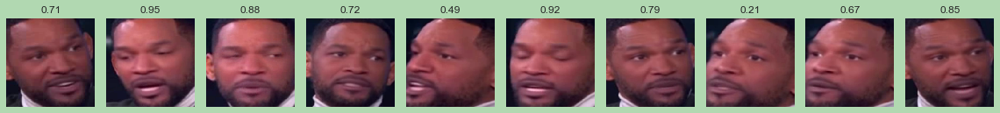

Label: fake
Fake prob: 0.44866514205932617


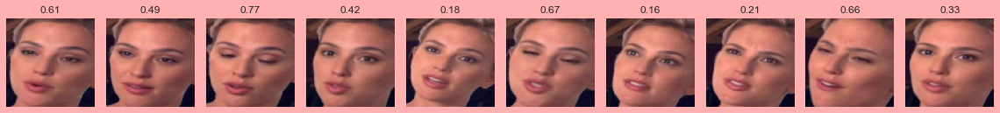

Label: fake
Fake prob: 0.689081609249115


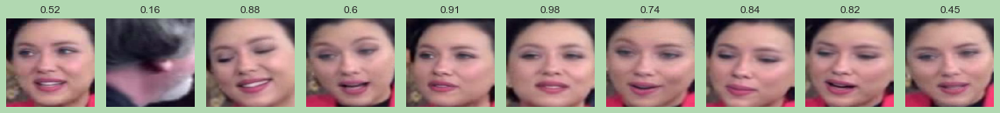

Label: fake
Fake prob: 0.7369663119316101


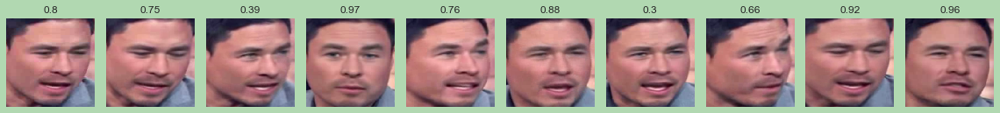

Label: fake
Fake prob: 0.9514034390449524


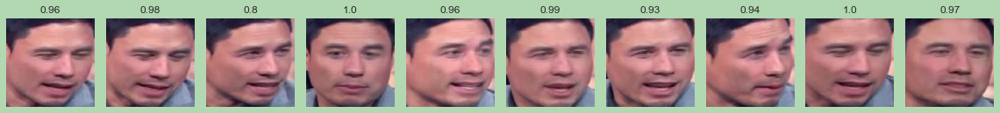

Label: fake
Fake prob: 0.9972861409187317


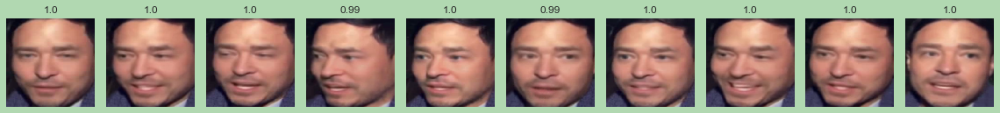

Label: fake
Fake prob: 0.9158135652542114


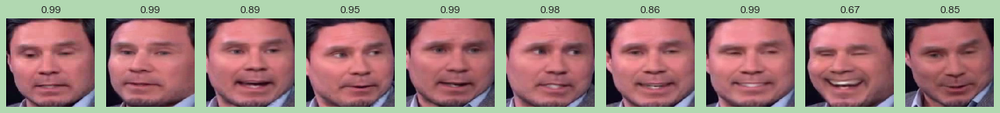

Label: real
Fake prob: 0.2710014283657074


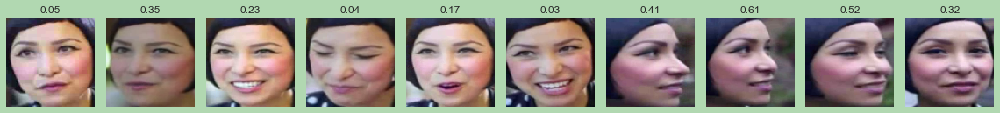

Label: real
Fake prob: 0.02402539923787117


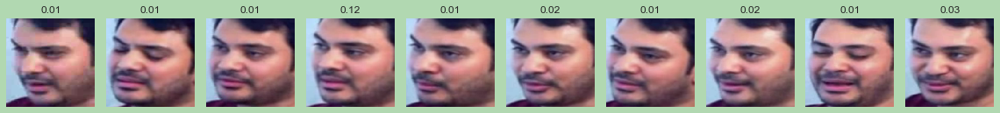

Label: real
Fake prob: 1.4565997616955428e-06


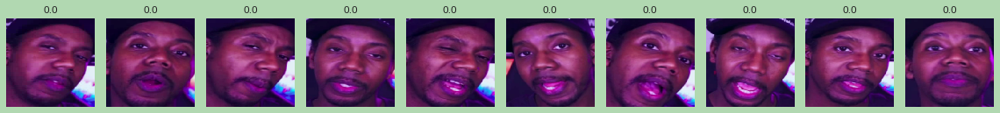

Label: real
Fake prob: 0.028118794783949852


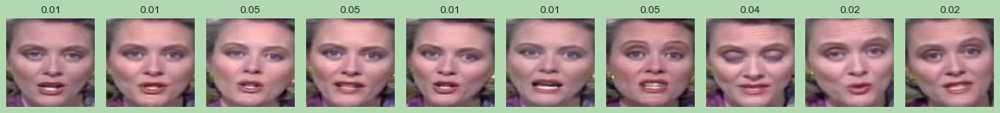

Label: real
Fake prob: 0.2916918396949768


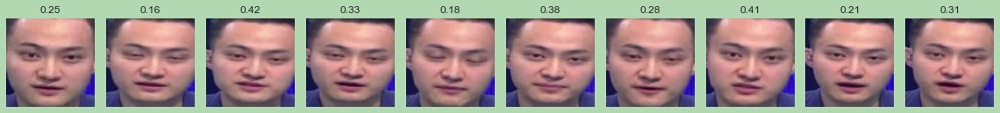

Label: real
Fake prob: 0.021258624270558357


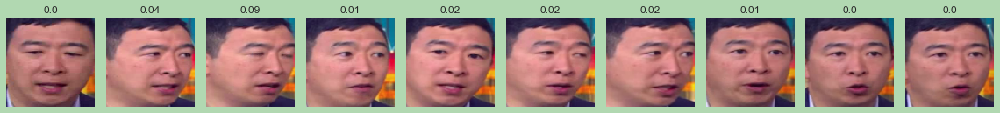

Label: real
Fake prob: 0.3279465138912201


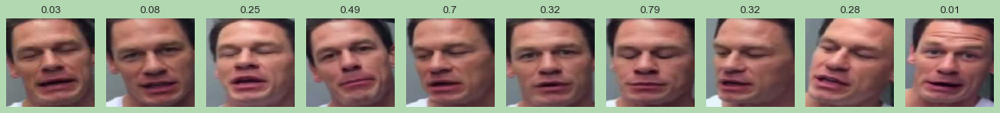

Label: real
Fake prob: 0.022006724029779434


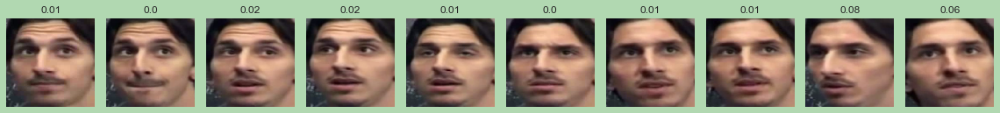

Label: real
Fake prob: 0.09982648491859436


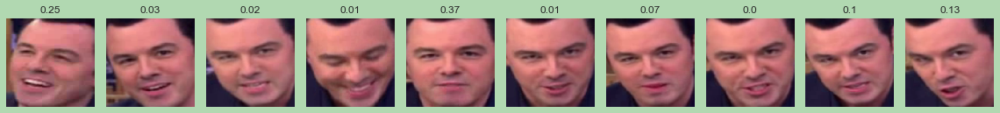

Label: real
Fake prob: 0.02256983518600464


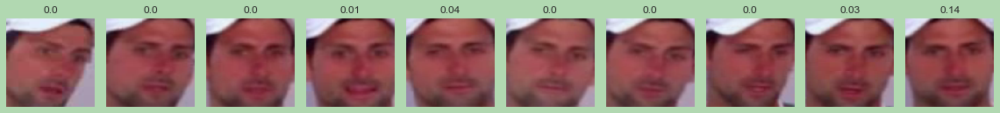

Label: real
Fake prob: 0.30721497535705566


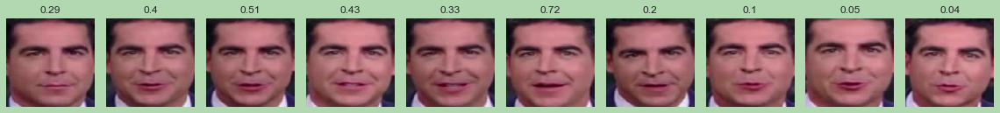

Label: real
Fake prob: 0.9756795763969421


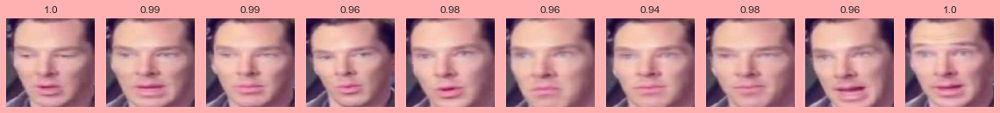

Label: real
Fake prob: 0.01361454464495182


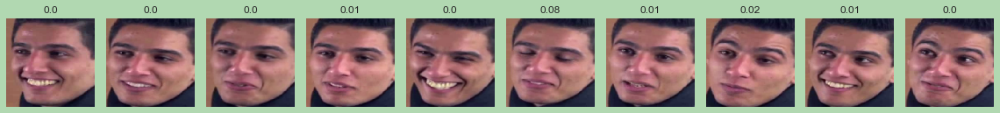

Label: real
Fake prob: 0.0006437550182454288


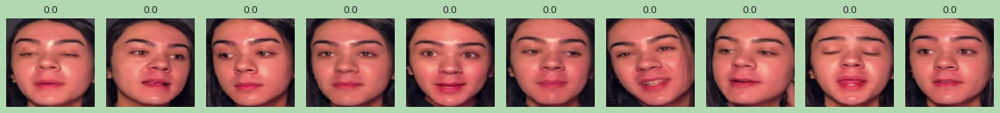

Label: real
Fake prob: 0.014306532219052315


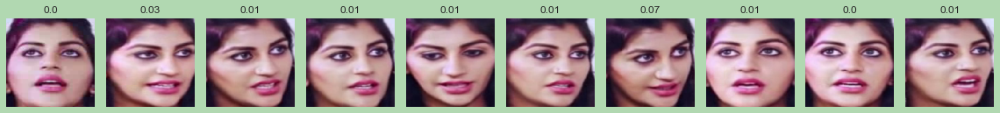

Label: real
Fake prob: 0.002653850009664893


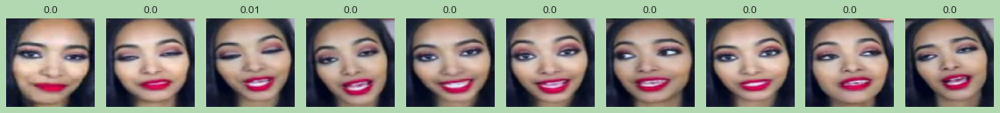

Label: real
Fake prob: 0.527245819568634


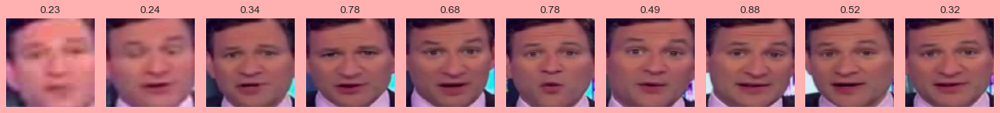

Label: real
Fake prob: 4.6295946958707646e-05


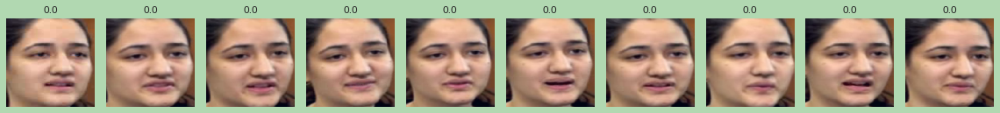

Label: real
Fake prob: 0.0738094225525856


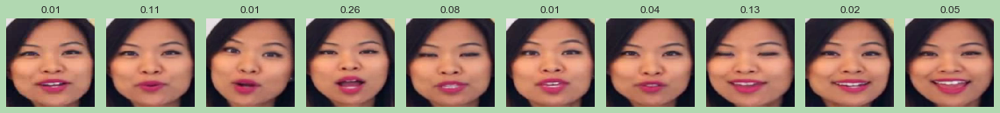

Label: real
Fake prob: 0.10418975353240967


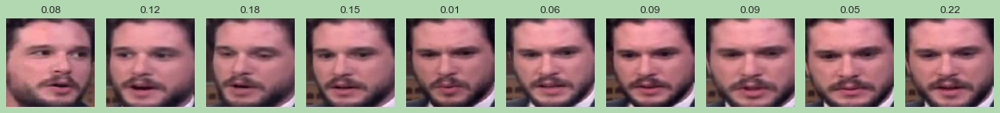

Label: real
Fake prob: 0.11533105373382568


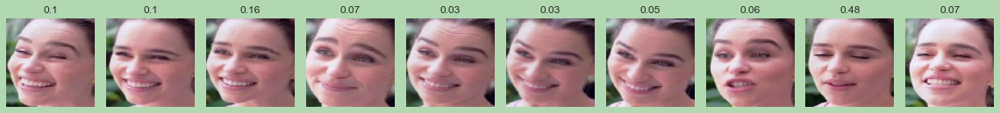

Label: real
Fake prob: 0.43619972467422485


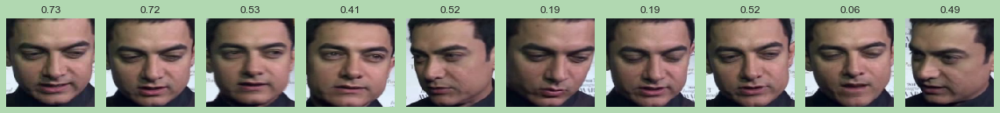

Label: real
Fake prob: 0.04323325678706169


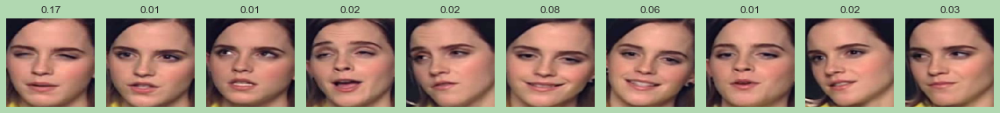

Label: real
Fake prob: 0.2974203824996948


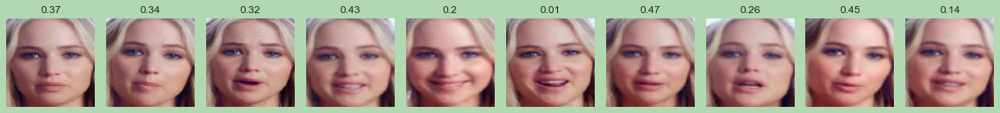

Label: real
Fake prob: 0.037739165127277374


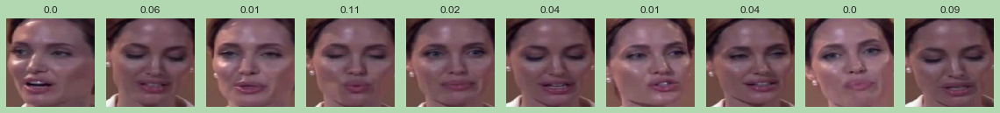

Label: real
Fake prob: 0.1621079444885254


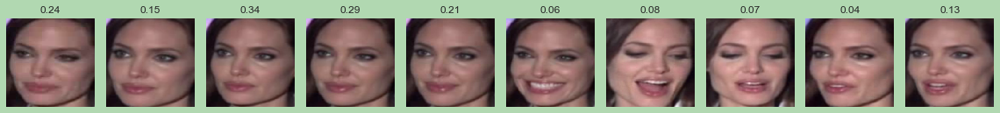

Label: real
Fake prob: 0.32451608777046204


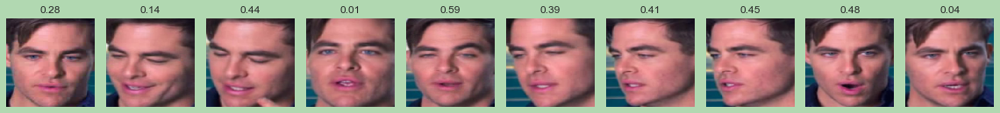

Label: real
Fake prob: 0.1397239863872528


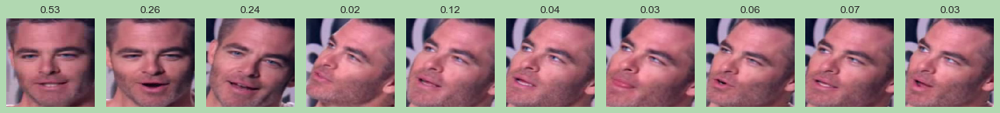

Label: real
Fake prob: 0.1990533471107483


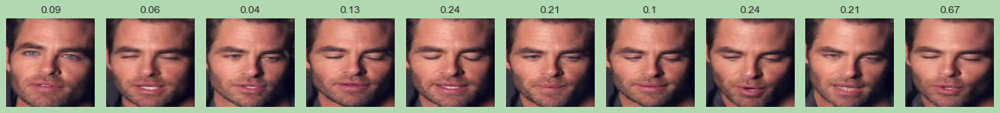

Label: real
Fake prob: 0.4879990518093109


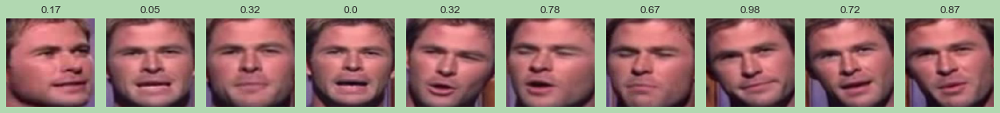

Label: real
Fake prob: 0.29971322417259216


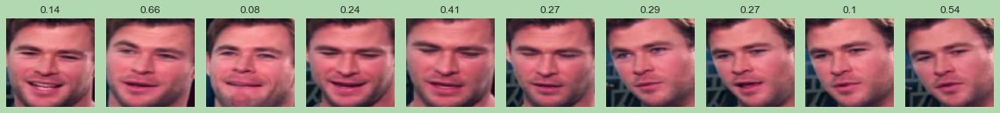

Label: real
Fake prob: 0.35492321848869324


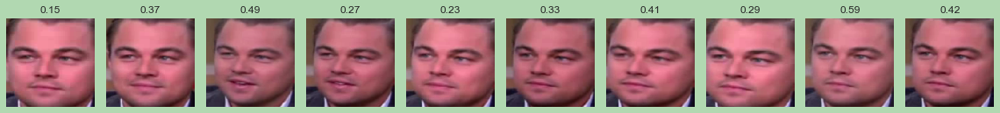

Label: real
Fake prob: 0.13243846595287323


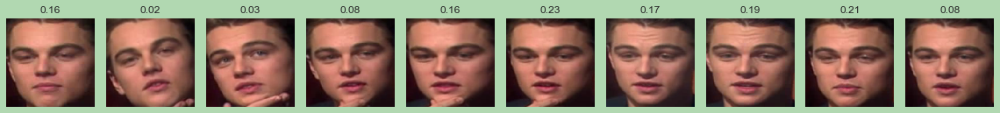

Label: real
Fake prob: 0.0638207495212555


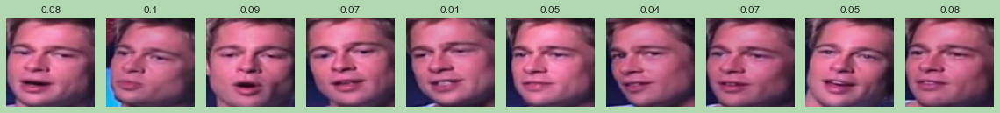

Label: real
Fake prob: 0.48970505595207214


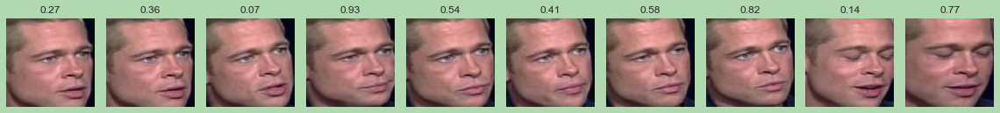

Label: real
Fake prob: 0.1054503470659256


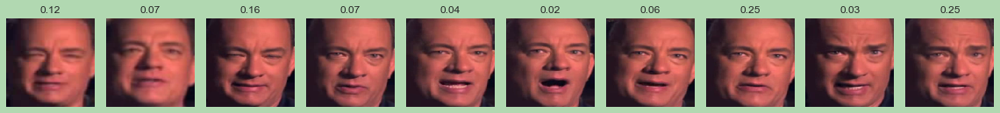

Label: real
Fake prob: 0.1458406299352646


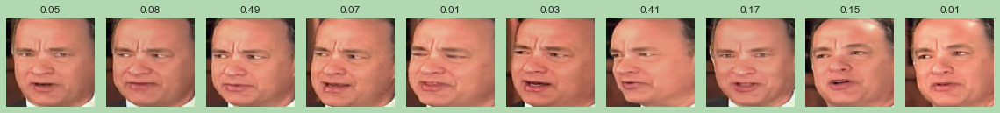

Label: real
Fake prob: 0.7756807208061218


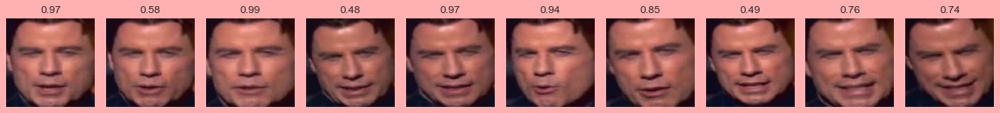

Label: real
Fake prob: 0.8625134825706482


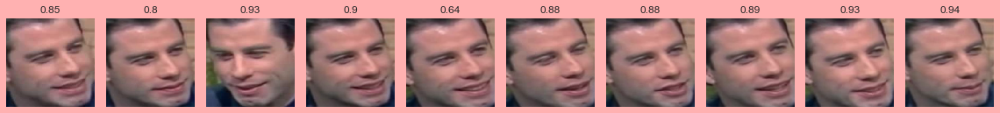

Label: real
Fake prob: 0.08759235590696335


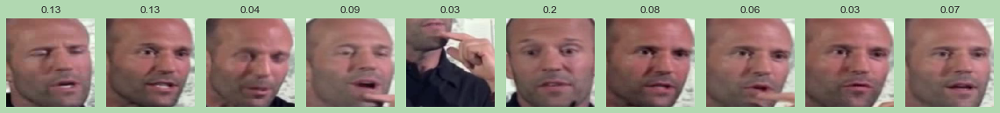

Label: real
Fake prob: 0.01953849010169506


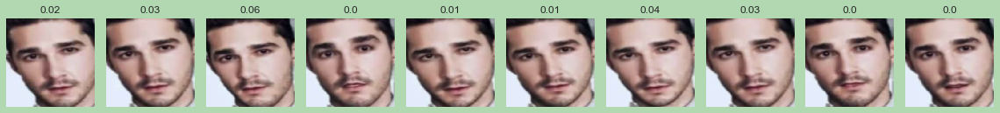

Label: real
Fake prob: 0.1592850536108017


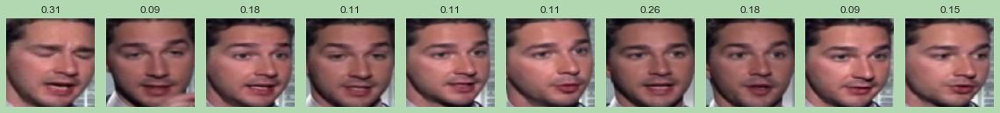

Label: real
Fake prob: 0.11035304516553879


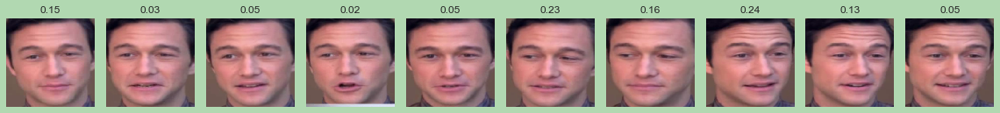

Label: real
Fake prob: 0.7122133374214172


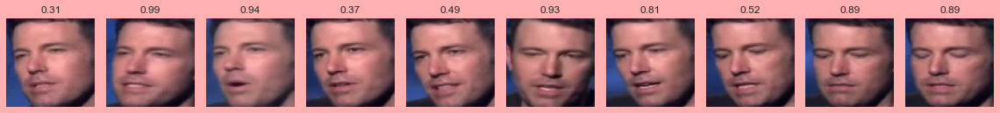

Label: real
Fake prob: 0.06452895700931549


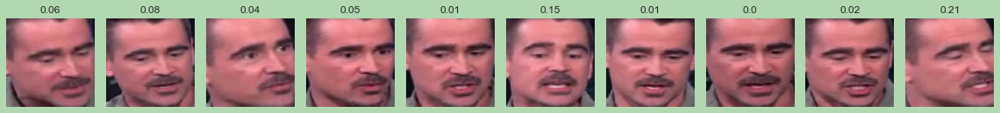

Label: real
Fake prob: 0.00525463093072176


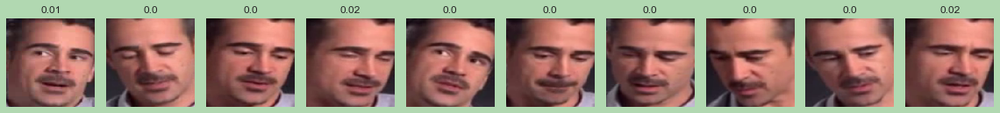

Label: real
Fake prob: 0.18629275262355804


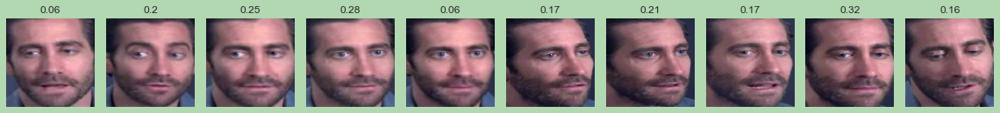

Label: real
Fake prob: 0.13828961551189423


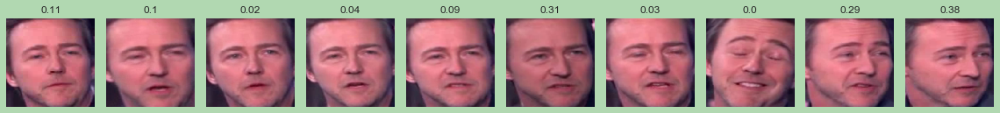

Label: real
Fake prob: 0.1956641525030136


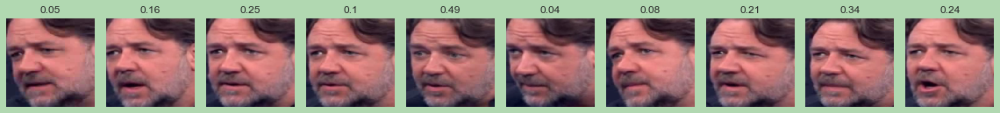

Label: real
Fake prob: 0.14314348995685577


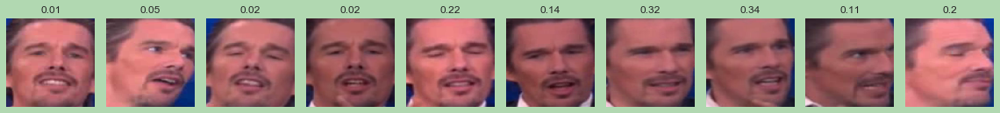

Label: real
Fake prob: 0.14650759100914001


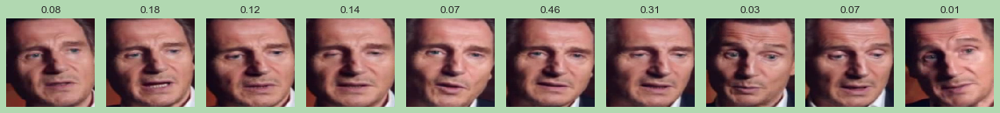

Label: real
Fake prob: 0.2818966507911682


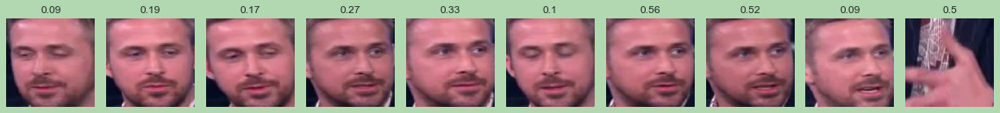

Label: real
Fake prob: 0.43013206124305725


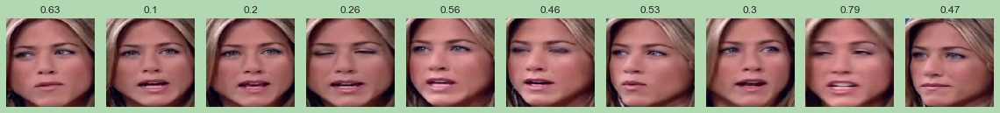

Label: real
Fake prob: 0.009983222000300884


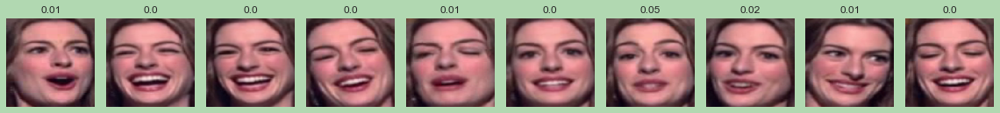

Label: real
Fake prob: 0.029210487380623817


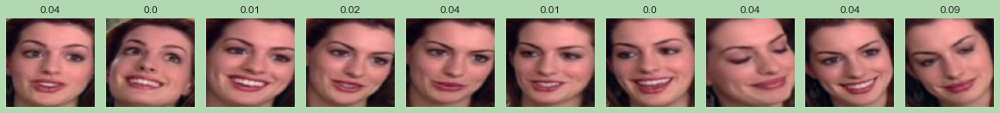

Label: real
Fake prob: 0.061993326991796494


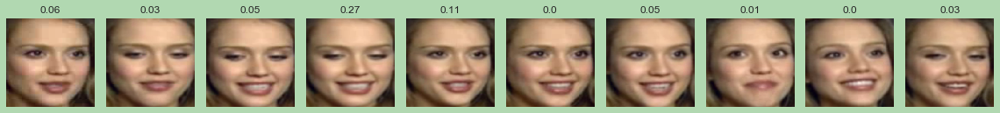

Label: real
Fake prob: 0.09556622803211212


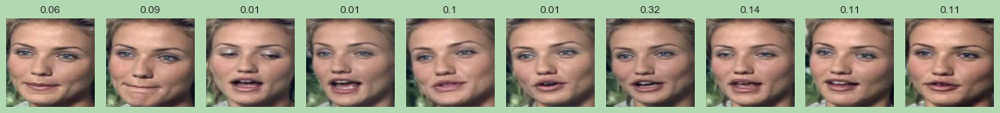

Label: real
Fake prob: 0.37610214948654175


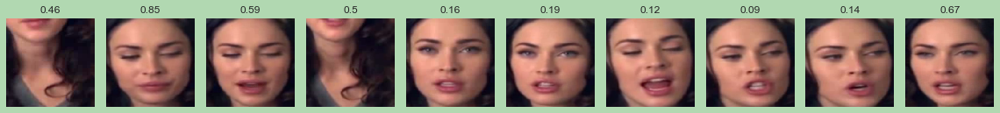

Label: real
Fake prob: 0.43205133080482483


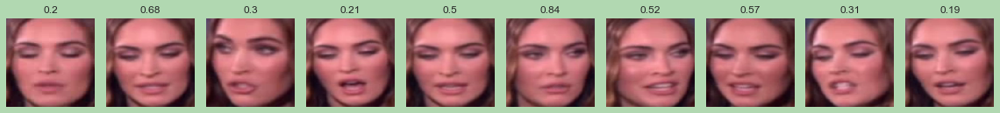

Label: real
Fake prob: 0.09936314076185226


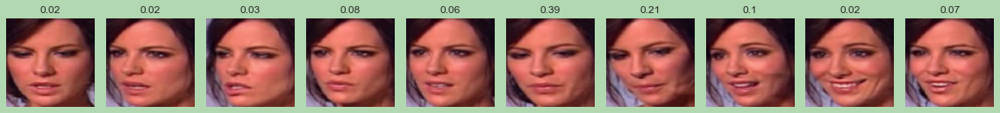

Label: real
Fake prob: 0.04302216321229935


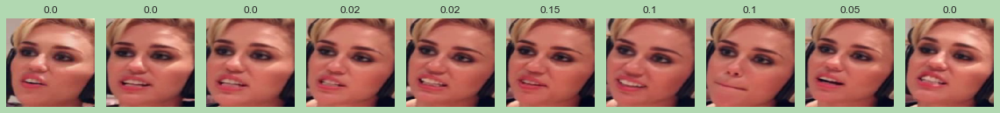

Label: real
Fake prob: 0.4278537333011627


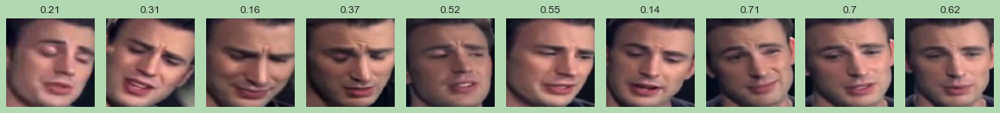

Label: real
Fake prob: 0.13744519650936127


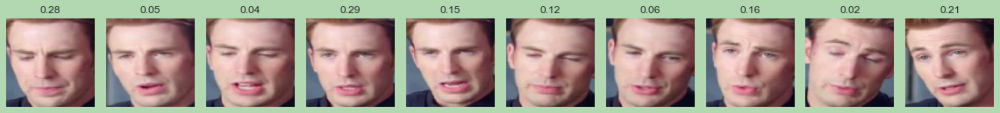

Label: real
Fake prob: 0.13007190823554993


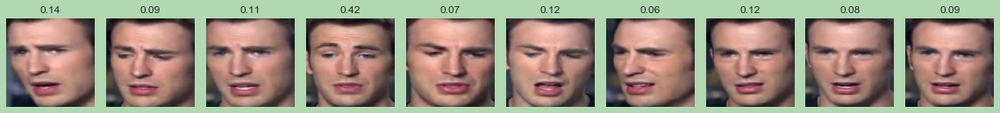

Label: real
Fake prob: 0.5695893168449402


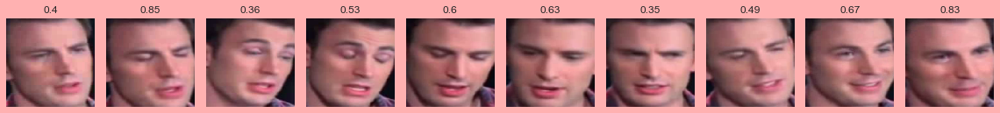

Label: real
Fake prob: 0.19778577983379364


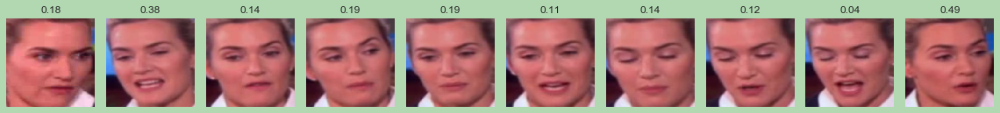

Label: real
Fake prob: 0.7674383521080017


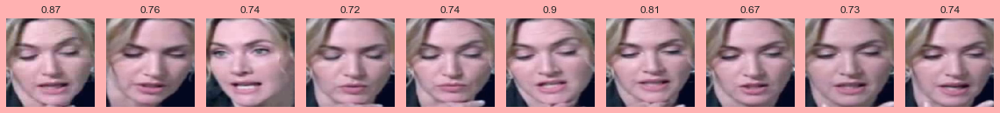

Label: real
Fake prob: 0.2739964723587036


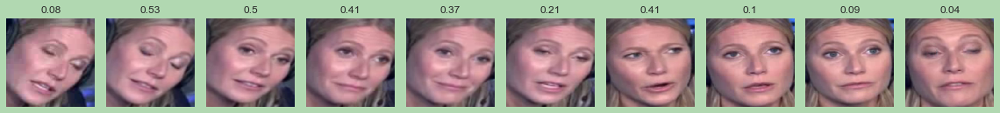

Label: real
Fake prob: 0.20231401920318604


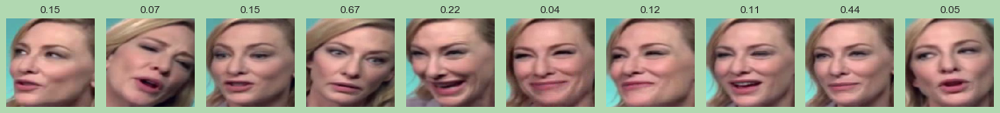

Label: real
Fake prob: 0.14978499710559845


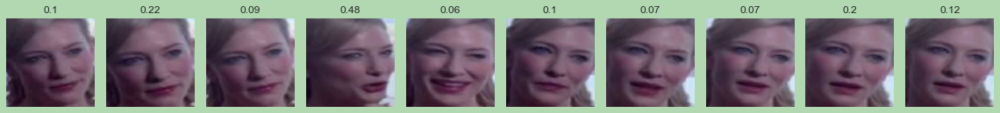

Label: real
Fake prob: 0.1321008950471878


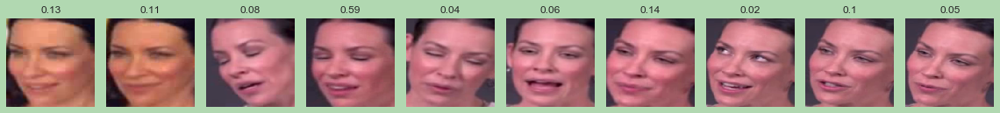

Label: real
Fake prob: 0.04682246223092079


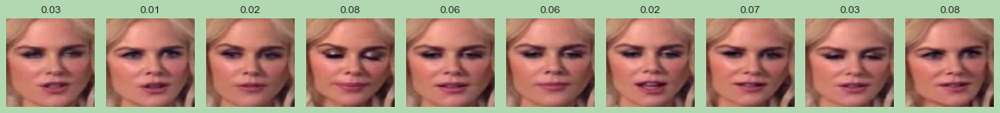

Label: real
Fake prob: 0.15719321370124817


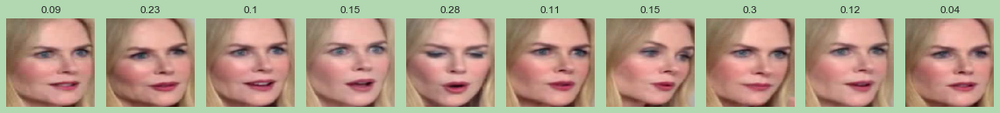

Label: real
Fake prob: 0.23415341973304749


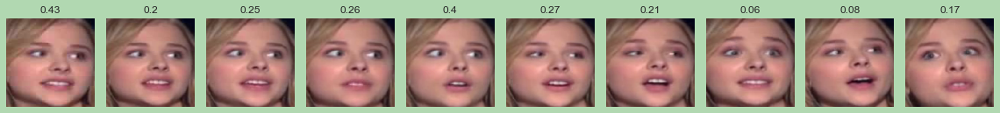

Label: real
Fake prob: 0.15802469849586487


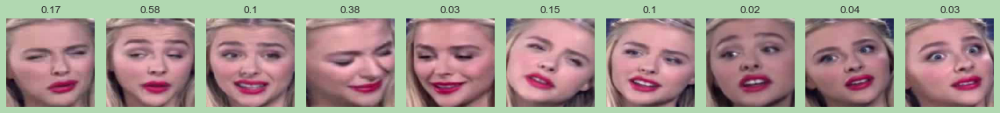

Label: real
Fake prob: 0.12468502670526505


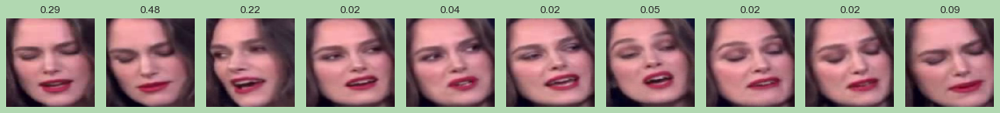

Label: real
Fake prob: 0.6610518097877502


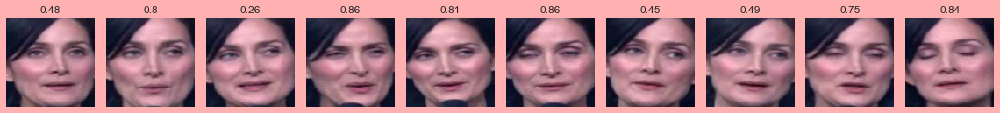

Label: real
Fake prob: 0.20082490146160126


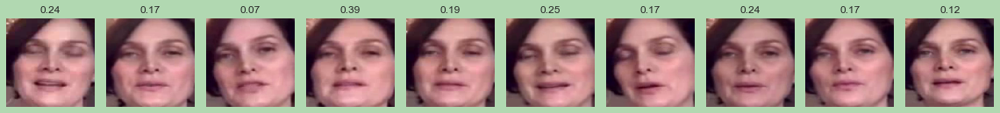

Label: real
Fake prob: 0.15695582330226898


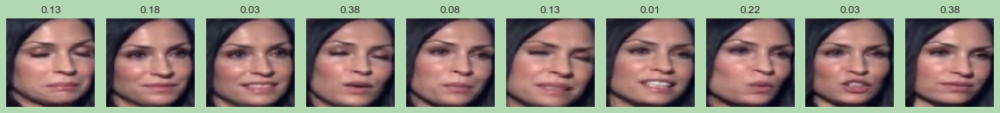

Label: real
Fake prob: 0.02041689120233059


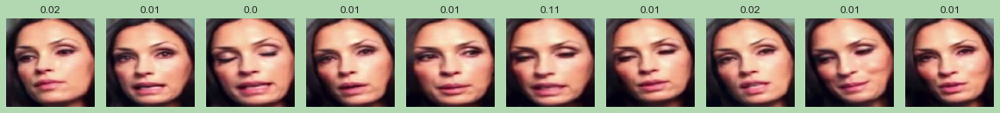

Label: real
Fake prob: 0.0962320938706398


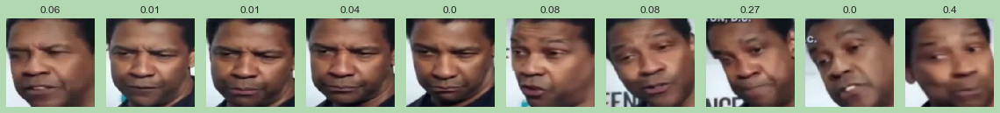

Label: real
Fake prob: 0.39159274101257324


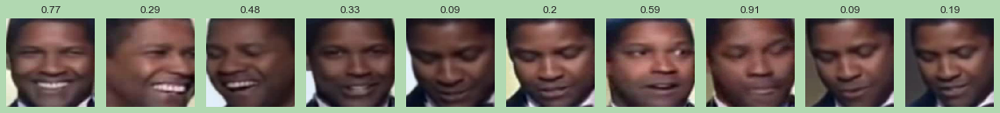

Label: real
Fake prob: 0.00900940503925085


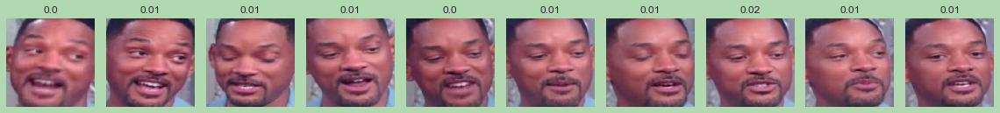

Label: real
Fake prob: 0.01088536437600851


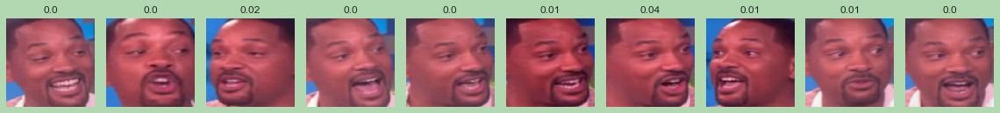

Label: real
Fake prob: 0.054828401654958725


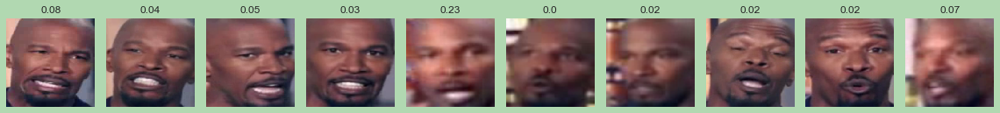

Label: real
Fake prob: 0.39483848214149475


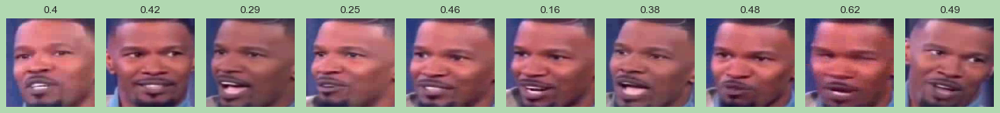

Label: real
Fake prob: 0.1619728058576584


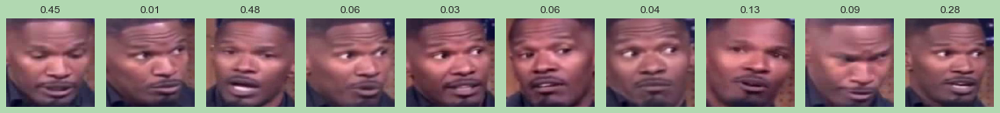

Label: real
Fake prob: 0.30333131551742554


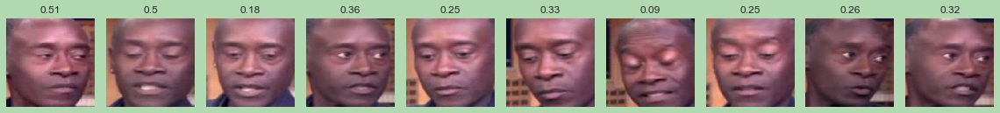

Label: real
Fake prob: 0.5346466898918152


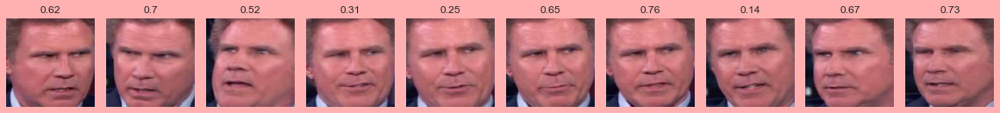

Label: real
Fake prob: 0.09621508419513702


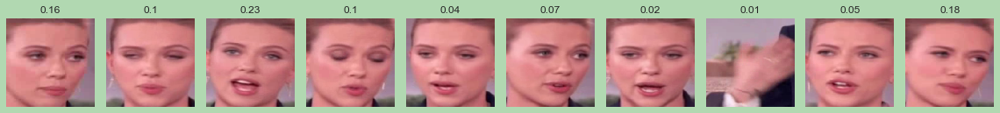

Label: real
Fake prob: 0.41726037859916687


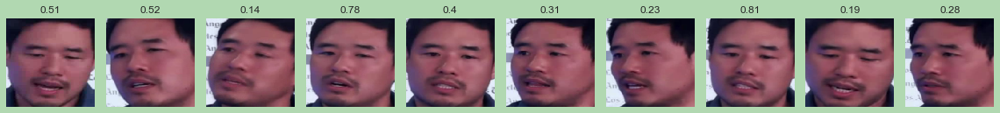

Length labels: 182
Length predictions: 182
Optimal threshold = 0.5065324902534485
Confusion matrix for threshold None
[[82  9]
 [ 7 84]]
[Acc: 0.912]
[Precision: 0.903]
[Recall: 0.923]
[F1: 0.913]


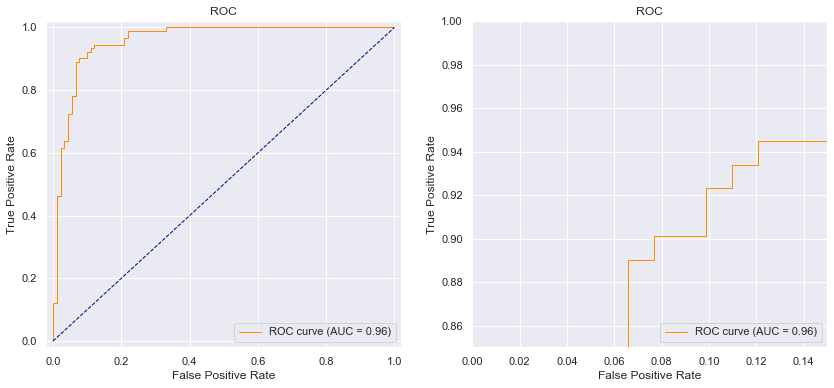

In [5]:
predict_files(model=model,
              path=file_path,
              n_frames=n_frames,
              device=device,
              agg='mean',
              temporal=temporal,
              plot_ims=True,
              threshold=None,
              verbose=True,
              log_metrics=False)


